# Programming Project #1: Hybrid Images

## CS445: Computational Photography - Fall 2019

### Part I: Hybrid Images

In [9]:
import cv2

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from scipy import signal
import scipy

import utils
from PIL import Image


In [10]:
%matplotlib notebook

# Hybrid Image One

In [11]:
im1_file = './tarik.jpg'
im2_file = './amar.jpg'

im1 = cv2.imread(im1_file, cv2.IMREAD_GRAYSCALE)
im2 = cv2.imread(im2_file, cv2.IMREAD_GRAYSCALE)

In [12]:
#pts_im1 = utils.prompt_eye_selection(im1)
pts_im1 = np.array([[ 764.80286,1694.7727 ],[1004.80286,1694.7727 ]])


In [13]:
#pts_im2 = utils.prompt_eye_selection(im2)
pts_im2 = np.array([[ 841.1665,1377.4999],[1092.0756,1388.4089]])

In [14]:
im1, im2 = utils.align_images(im1_file, im2_file,pts_im1,pts_im2,save_images=False)

In [15]:
# convert to grayscale
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY) / 255.0
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY) / 255.0

<IPython.core.display.Javascript object>


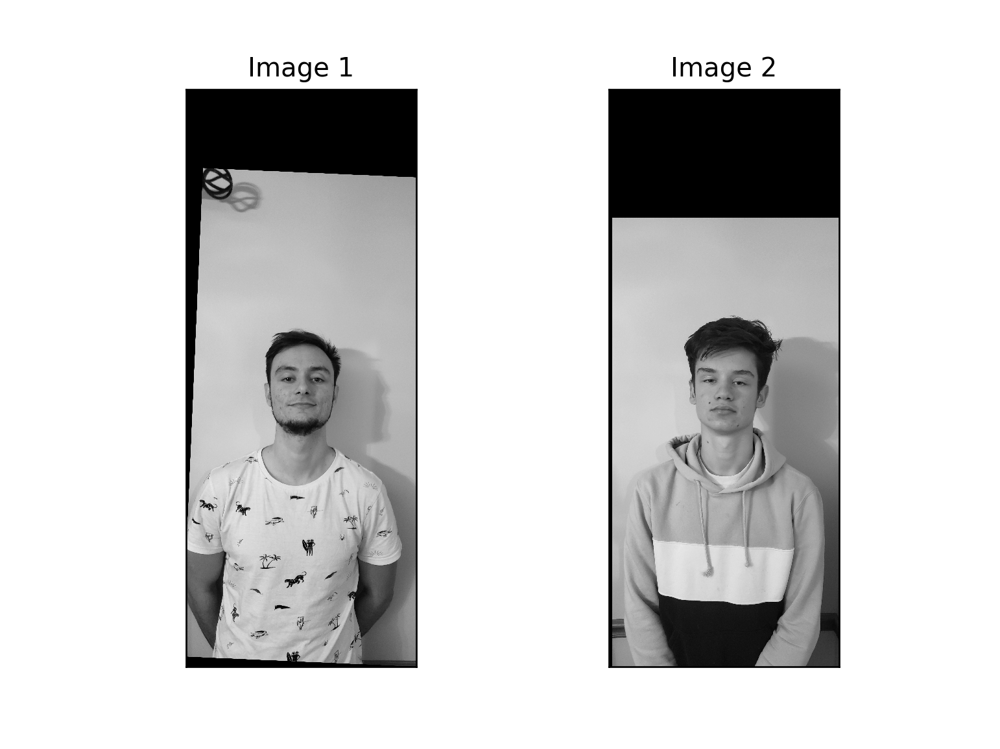

In [16]:
#Images sanity check
fig, axes = plt.subplots(1, 2)
axes[0].imshow(im1,cmap='gray')
axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im2,cmap='gray')
axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);

In [17]:
def hybridImage(im1, im2, cutoff_low, cutoff_high):
    '''
    Inputs:
        im1:    RGB (height x width x 3) or a grayscale (height x width) image
                as a numpy array.
        im2:    RGB (height x width x 3) or a grayscale (height x width) image
                as a numpy array.
        cutoff_low: standard deviation for the low-pass filter
        cutoff_high: standard deviation for the high-pass filter
        
    Output:
        Return the combination of both images, one filtered with a low-pass filter
        and the other with a high-pass filter.
    ''' 
    
    fil_high = utils.gaussian_kernel(cutoff_high, round(cutoff_high * 3))
    im_fil_2 = cv2.filter2D(im2,-1,fil_high)
    lp = im2 - im_fil_2
    
    fil_low = utils.gaussian_kernel(cutoff_low, round(cutoff_low * 3))
    im_fil_1 = cv2.filter2D(im1,-1,fil_low)

    

    hybrid = lp + im_fil_1
    
    return hybrid, lp, im_fil_1
    


In [18]:
arbitrary_value = 2  # you should choose meaningful values; you might want to set to a fraction of image size
cutoff_low = 7
cutoff_high = 12

hybrid,lp,gaus = hybridImage(im1, im2, cutoff_low, cutoff_high)

<IPython.core.display.Javascript object>


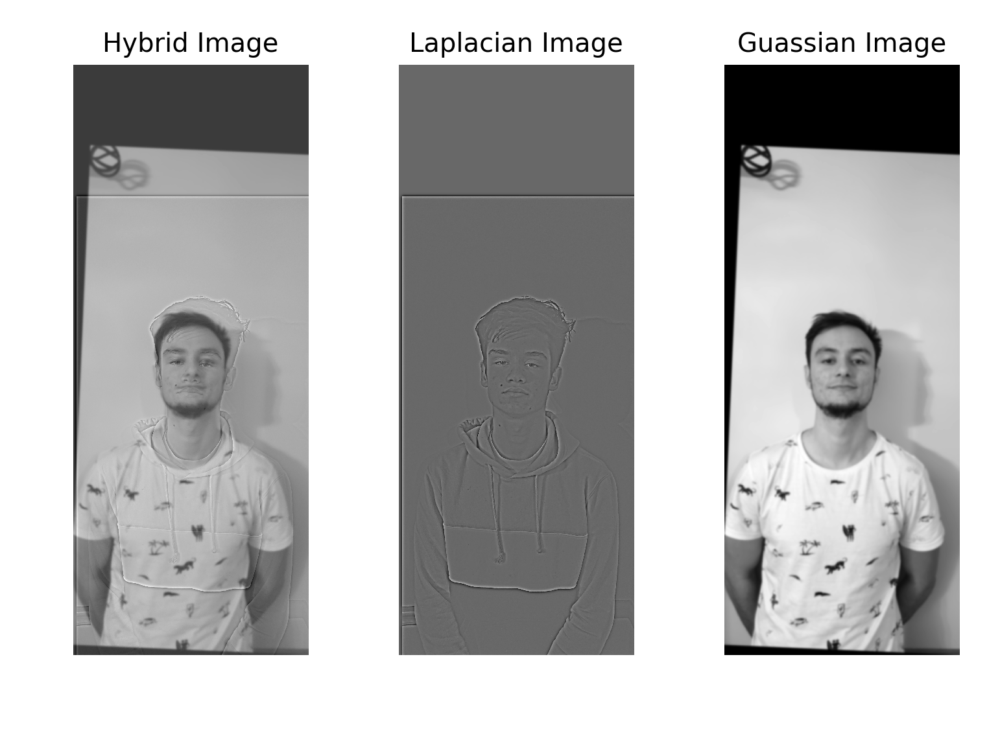

In [19]:

fig, axes = plt.subplots(1,3)
fig.tight_layout()
axes[0].imshow(hybrid, cmap='gray')
axes[1].imshow(lp, cmap='gray')
axes[2].imshow(gaus, cmap='gray')
axes[0].axis('off')
axes[1].axis('off')
axes[2].axis('off')
axes[0].title.set_text('Hybrid Image')
axes[1].title.set_text('Laplacian Image')
axes[2].title.set_text('Guassian Image')
plt.savefig('tarik_amar_compare.png')






<IPython.core.display.Javascript object>


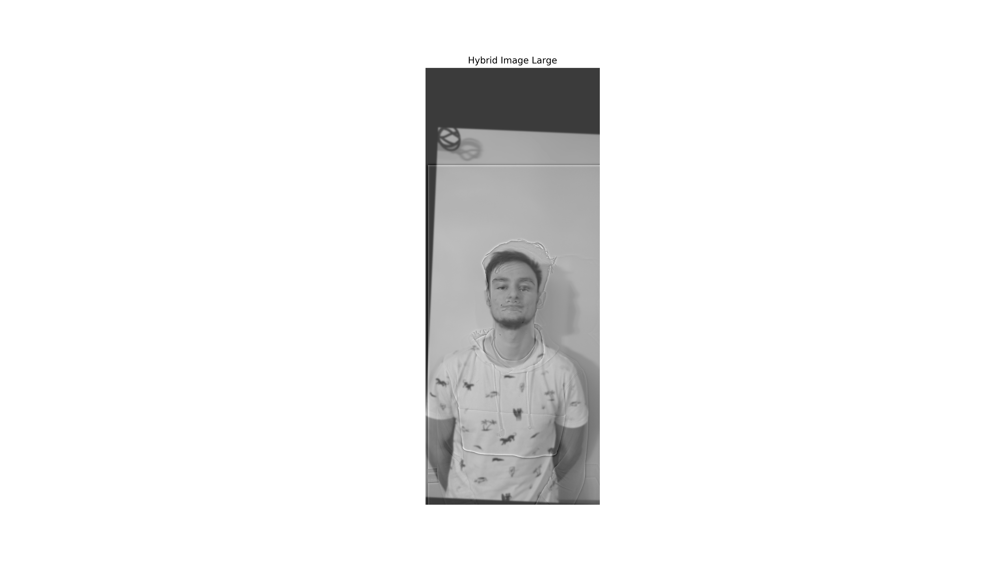

In [20]:
fig, axes = plt.subplots(1,1)
axes.imshow(hybrid, cmap='gray')
axes.axis('off')
axes.title.set_text('Hybrid Image Large')
fig.set_size_inches(18.5, 10.5)
plt.savefig('tarik_amar.png')

<IPython.core.display.Javascript object>


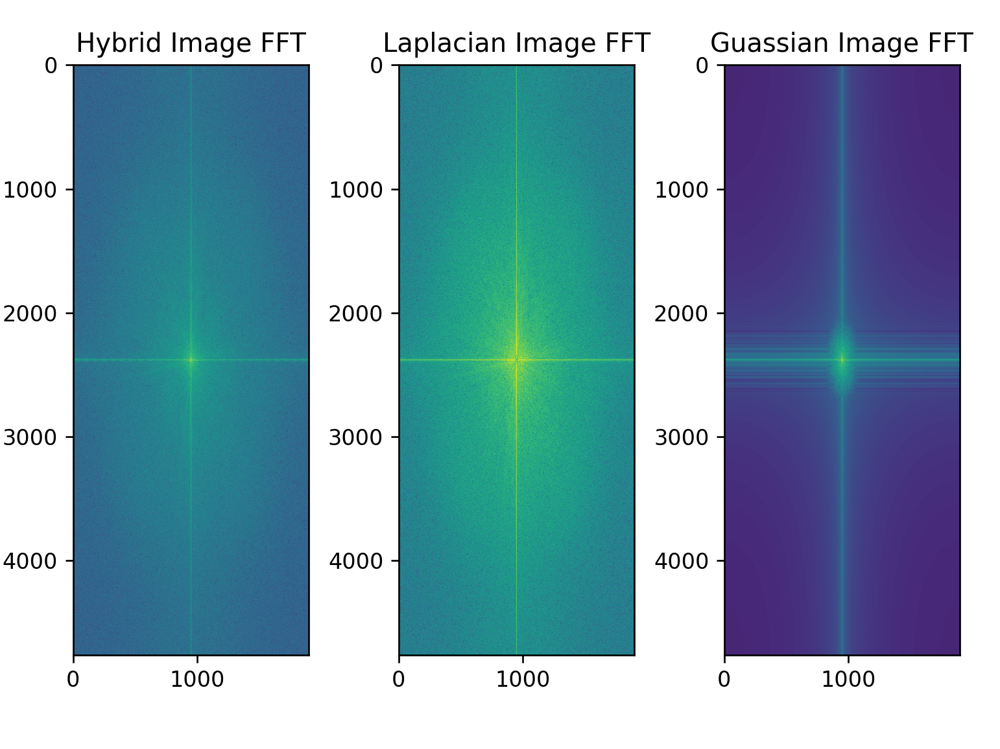

In [62]:
hybrid_fft = np.log(np.abs(np.fft.fftshift(np.fft.fft2(hybrid))))
lp_fft = np.log(np.abs(np.fft.fftshift(np.fft.fft2(lp))))
gaus_fft = np.log(np.abs(np.fft.fftshift(np.fft.fft2(gaus))))

fig, axes = plt.subplots(1,3)
fig.tight_layout()
axes[0].imshow(hybrid_fft)
axes[1].imshow(lp_fft)
axes[2].imshow(gaus_fft)
#axes[0].axis('off')
#axes[1].axis('off')
#axes[2].axis('off')
axes[0].title.set_text('Hybrid Image FFT')
axes[1].title.set_text('Laplacian Image FFT')
axes[2].title.set_text('Guassian Image FFT')
plt.savefig('tarik_amar_compare_fft.png')



# Hyrbrid Image 2

In [22]:
im3_file = './samra.jpg'
im4_file = './mukki.jpg'

im3 = cv2.imread(im3_file, cv2.IMREAD_GRAYSCALE)
im4 = cv2.imread(im4_file, cv2.IMREAD_GRAYSCALE)

In [23]:
#pts_im3 = utils.prompt_eye_selection(im3)
pts_im3 = np.array([[ 355.27587891,228.42596436],[ 443.70388794,212.18408203]])

In [24]:
#pts_im4 = utils.prompt_eye_selection(im4)
pts_im4 = np.array([[ 1738.0057373,609.94158936],[ 2062.27514648,603.04223633]])

<IPython.core.display.Javascript object>


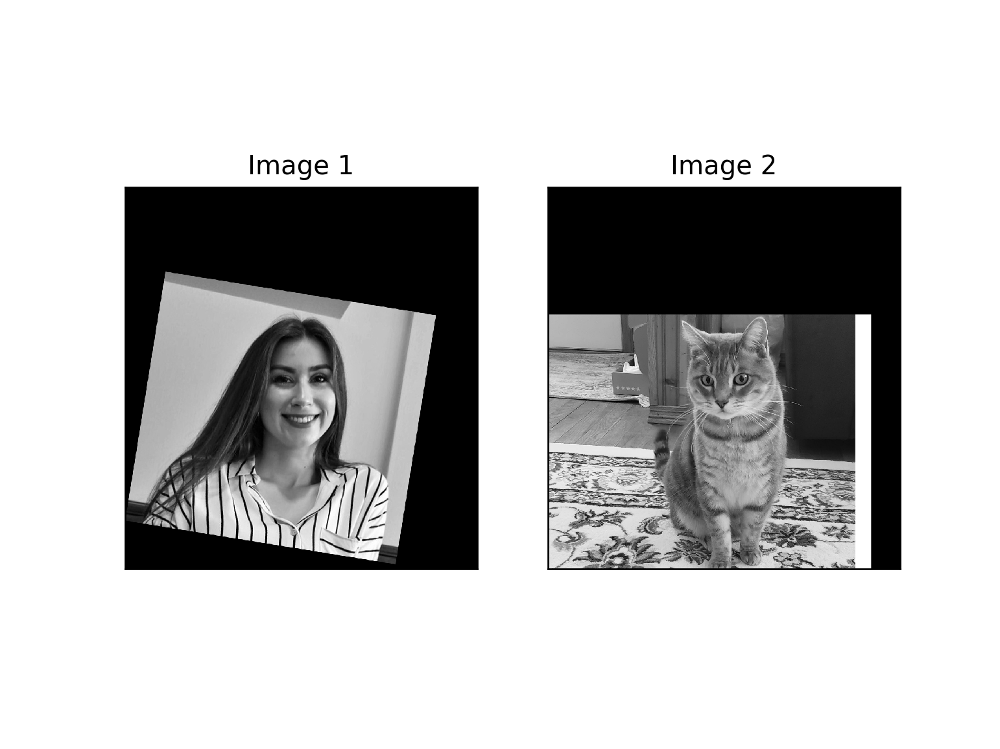

In [25]:
im3, im4 = utils.align_images(im3_file, im4_file,pts_im3,pts_im4,save_images=False)

# convert to grayscale
im3 = cv2.cvtColor(im3, cv2.COLOR_BGR2GRAY) / 255.0
im4 = cv2.cvtColor(im4, cv2.COLOR_BGR2GRAY) / 255.0

#Images sanity check
fig, axes = plt.subplots(1, 2)
axes[0].imshow(im3,cmap='gray')
axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im4,cmap='gray')
axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);


In [26]:
cutoff_low = 7
cutoff_high = 12

hybrid_2,lp_2,gaus_2 = hybridImage(im3, im4, cutoff_low, cutoff_high)

<IPython.core.display.Javascript object>


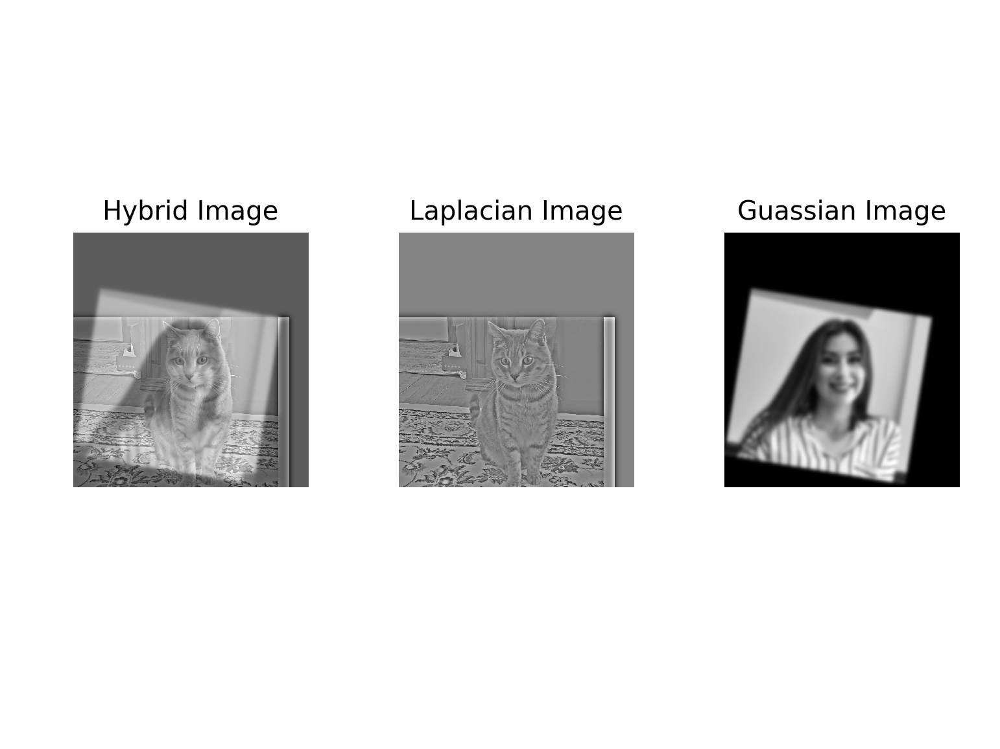

In [27]:
fig, axes = plt.subplots(1,3)
fig.tight_layout()
axes[0].imshow(hybrid_2, cmap='gray')
axes[1].imshow(lp_2, cmap='gray')
axes[2].imshow(gaus_2, cmap='gray')
axes[0].axis('off')
axes[1].axis('off')
axes[2].axis('off')
axes[0].title.set_text('Hybrid Image')
axes[1].title.set_text('Laplacian Image')
axes[2].title.set_text('Guassian Image')
plt.savefig('samra_mukki_compare.png')

<IPython.core.display.Javascript object>


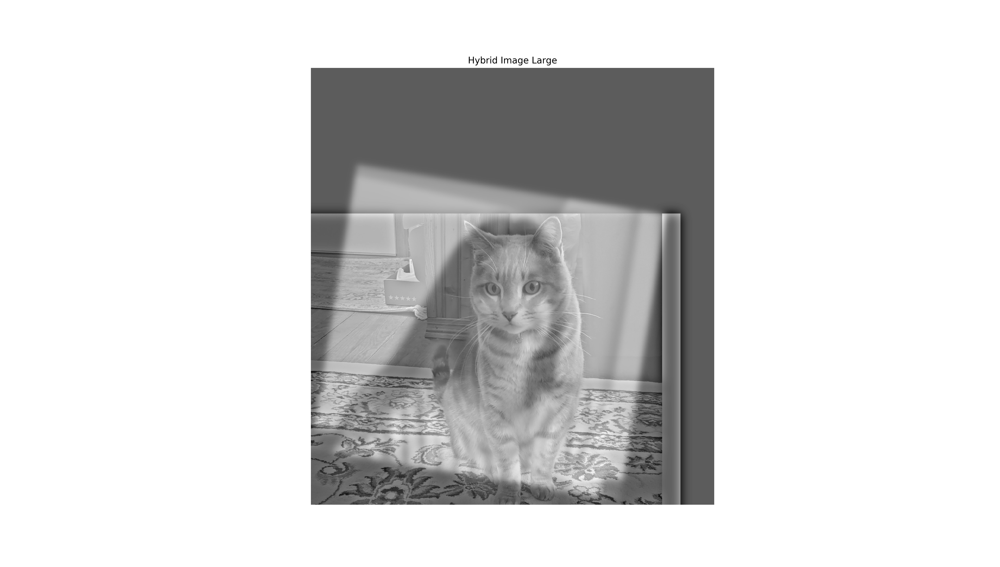

In [28]:
fig, axes = plt.subplots(1,1)
axes.imshow(hybrid_2, cmap='gray')
axes.axis('off')
axes.title.set_text('Hybrid Image Large')
fig.set_size_inches(18.5, 10.5)
plt.savefig('samra_mukki.png')

<IPython.core.display.Javascript object>


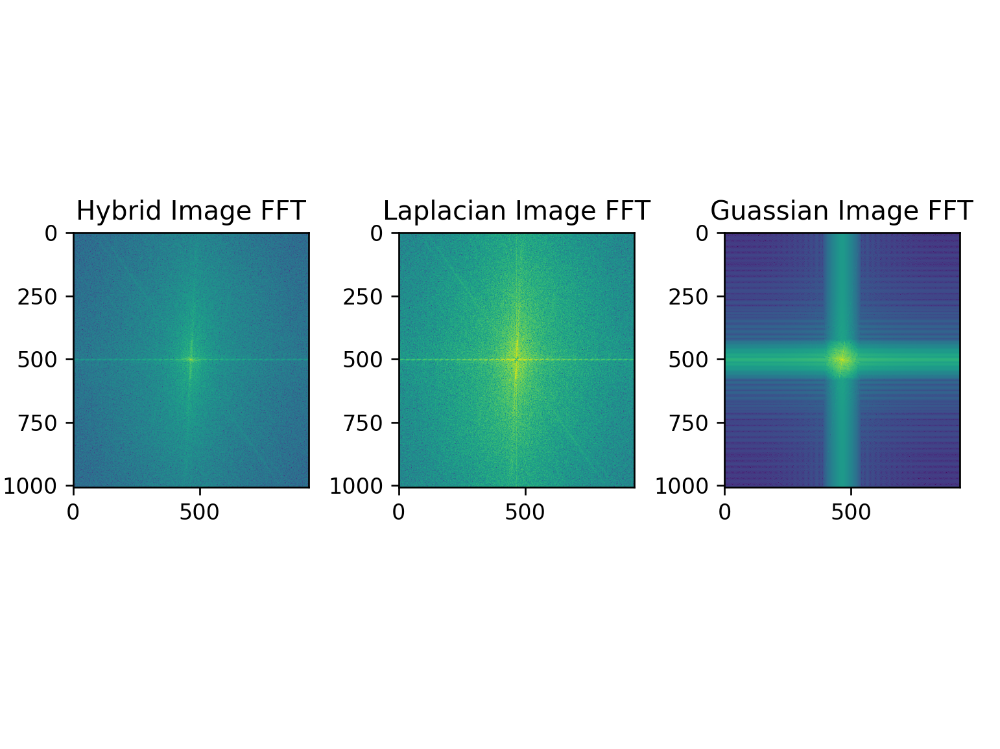

In [29]:
hybrid_fft_2 = np.log(np.abs(np.fft.fftshift(np.fft.fft2(hybrid_2))))
lp_fft_2 = np.log(np.abs(np.fft.fftshift(np.fft.fft2(lp_2))))
gaus_fft_2 = np.log(np.abs(np.fft.fftshift(np.fft.fft2(gaus_2))))

fig, axes = plt.subplots(1,3)
fig.tight_layout()
axes[0].imshow(hybrid_fft_2)
axes[1].imshow(lp_fft_2)
axes[2].imshow(gaus_fft_2)
#axes[0].axis('off')
#axes[1].axis('off')
#axes[2].axis('off')
axes[0].title.set_text('Hybrid Image FFT')
axes[1].title.set_text('Laplacian Image FFT')
axes[2].title.set_text('Guassian Image FFT')
plt.savefig('samra_mukki_compare_fft.png')

# Hybrid Image 3

In [30]:
#https://www.pngitem.com/so/lion-face/
im5_file = './lion.jpg'
im5 = cv2.imread(im5_file, cv2.IMREAD_GRAYSCALE)

im1_file = './tarik.jpg'
im1 = cv2.imread(im1_file, cv2.IMREAD_GRAYSCALE)
pts_im1 = np.array([[ 764.80286,1694.7727 ],[1004.80286,1694.7727 ]])

#pts_im5 = utils.prompt_eye_selection(im5)
pts_im5 = np.array([[ 253.44638062,211.5670166 ],[ 367.40472412,213.04699707]])


<IPython.core.display.Javascript object>


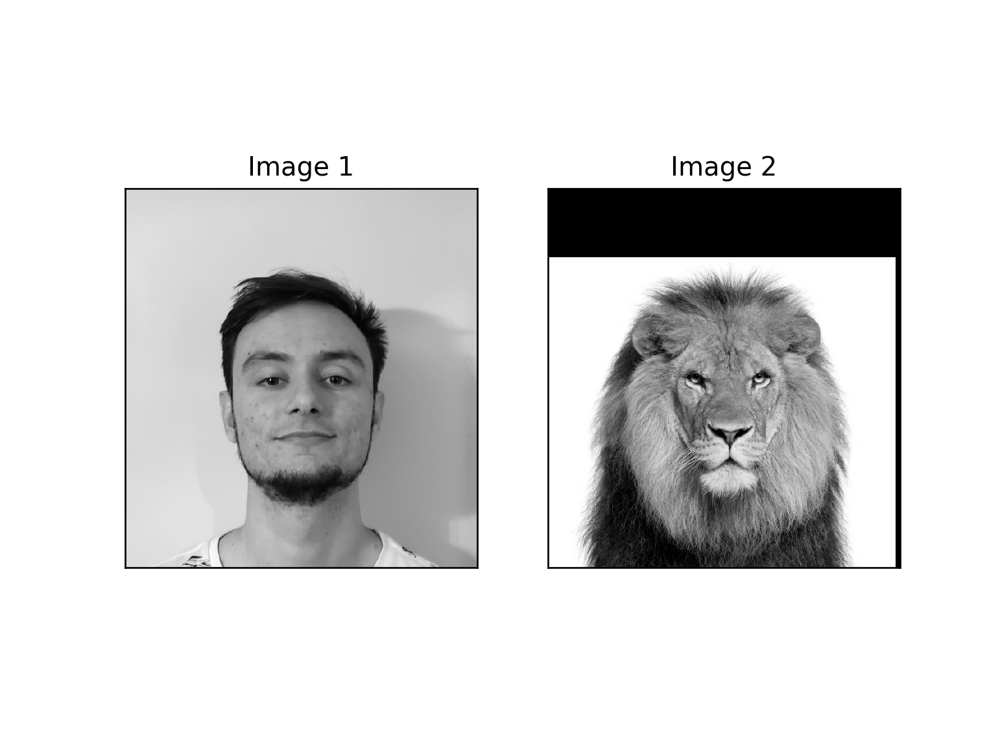

In [31]:
im1, im5 = utils.align_images(im1_file, im5_file,pts_im1,pts_im5,save_images=False)

# convert to grayscale
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY) / 255.0
im5 = cv2.cvtColor(im5, cv2.COLOR_BGR2GRAY) / 255.0

#Images sanity check
fig, axes = plt.subplots(1, 2)
axes[0].imshow(im1,cmap='gray')
axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im5,cmap='gray')
axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);

In [32]:
cutoff_low = 3
cutoff_high = 5

hybrid_3,lp_3,gaus_3 = hybridImage(im1,im5, cutoff_low, cutoff_high)

<IPython.core.display.Javascript object>


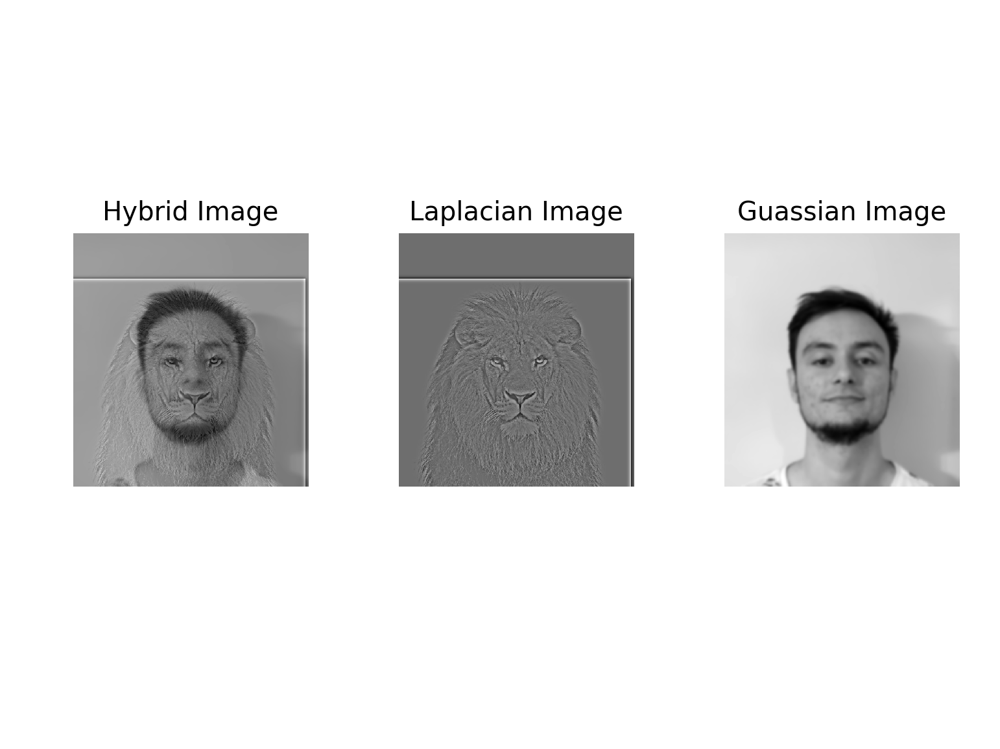

In [33]:
fig, axes = plt.subplots(1,3)
fig.tight_layout()
axes[0].imshow(hybrid_3, cmap='gray')
axes[1].imshow(lp_3, cmap='gray')
axes[2].imshow(gaus_3, cmap='gray')
axes[0].axis('off')
axes[1].axis('off')
axes[2].axis('off')
axes[0].title.set_text('Hybrid Image')
axes[1].title.set_text('Laplacian Image')
axes[2].title.set_text('Guassian Image')
plt.savefig('tarik_lion_compare.png')

<IPython.core.display.Javascript object>


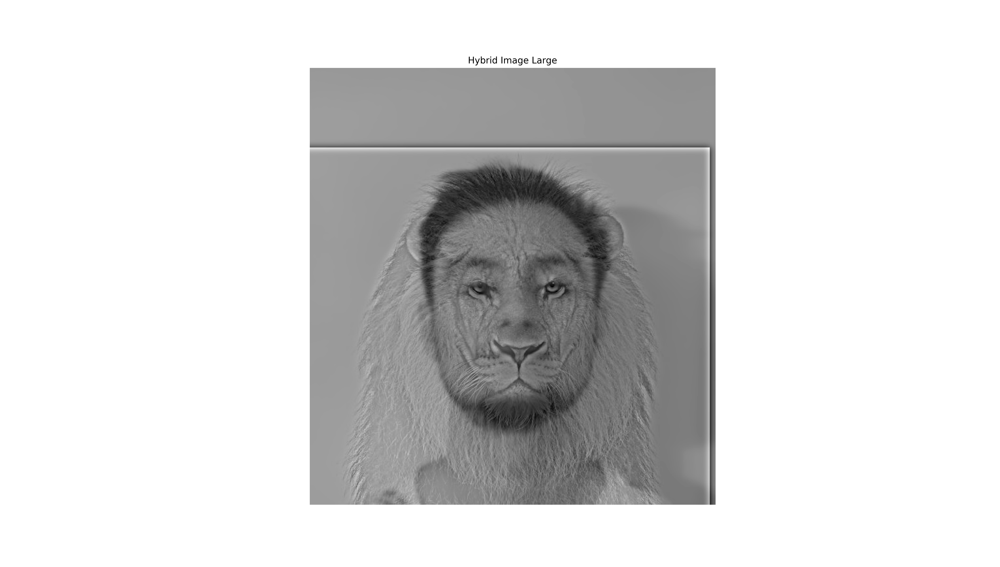

In [34]:
fig, axes = plt.subplots(1,1)
axes.imshow(hybrid_3, cmap='gray')
axes.axis('off')
axes.title.set_text('Hybrid Image Large')
fig.set_size_inches(18.5, 10.5)
plt.savefig('tarik_lion.png')

<IPython.core.display.Javascript object>


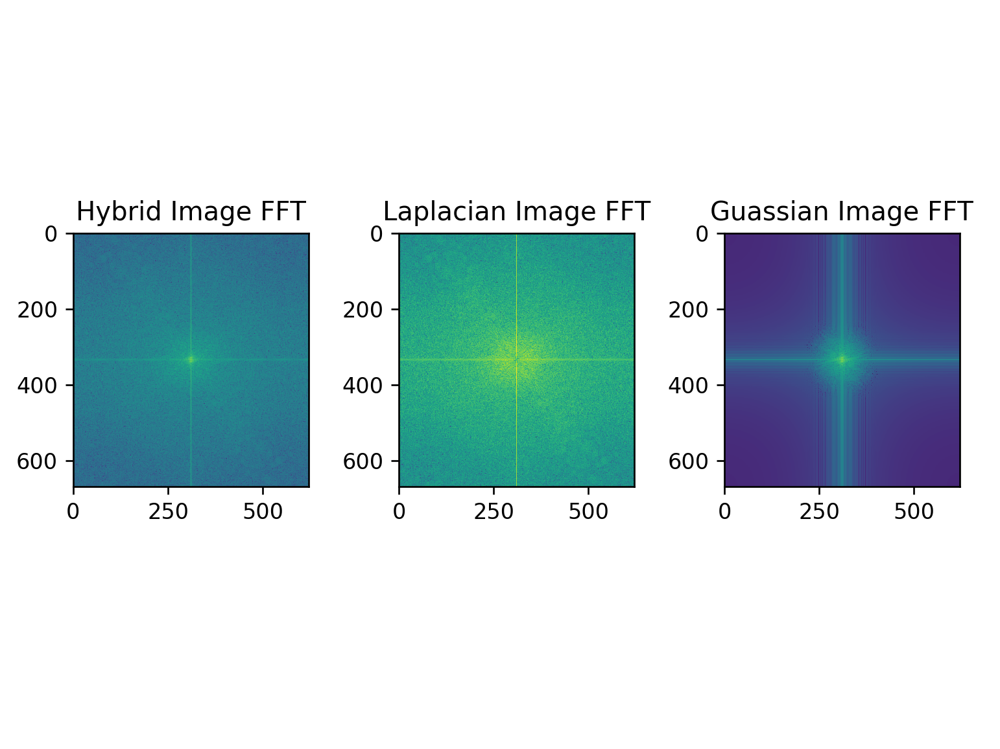

In [35]:
hybrid_fft_3 = np.log(np.abs(np.fft.fftshift(np.fft.fft2(hybrid_3))))
lp_fft_3 = np.log(np.abs(np.fft.fftshift(np.fft.fft2(lp_3))))
gaus_fft_3 = np.log(np.abs(np.fft.fftshift(np.fft.fft2(gaus_3))))

fig, axes = plt.subplots(1,3)
fig.tight_layout()
axes[0].imshow(hybrid_fft_3)
axes[1].imshow(lp_fft_3)
axes[2].imshow(gaus_fft_3)
#axes[0].axis('off')
#axes[1].axis('off')
#axes[2].axis('off')
axes[0].title.set_text('Hybrid Image FFT')
axes[1].title.set_text('Laplacian Image FFT')
axes[2].title.set_text('Guassian Image FFT')
plt.savefig('tarik_lion_compare_fft.png')

# Part II: Image Enhancement

##### Two out of three types of image enhancement are required.  Choose a good image to showcase each type and implement a method.  This code doesn't rely on the hybrid image part.

## Contrast enhancement

<IPython.core.display.Javascript object>


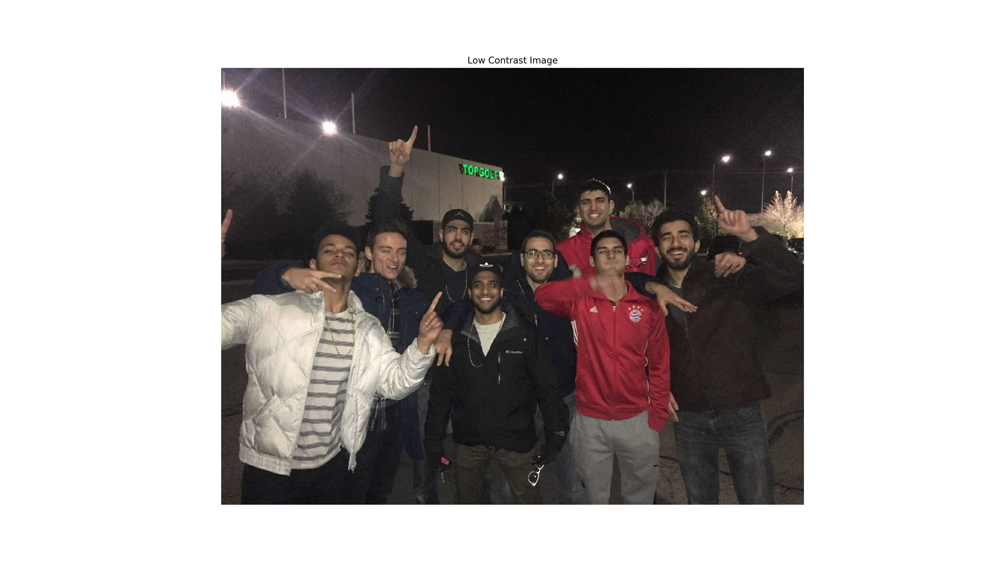

In [36]:
#https://howgreenisyourgarden.wordpress.com/2014/03/10/using-low-contrast-filters-for-video/
im6_file = './low_contrast.jpg'

image6 = cv2.imread(im6_file)
im6 = cv2.cvtColor(image6, cv2.COLOR_BGR2RGB)

fig, axes = plt.subplots(1,1)
axes.imshow(im6)
axes.axis('off')
axes.title.set_text('Low Contrast Image')
fig.set_size_inches(18.5, 10.5)
plt.show()


<IPython.core.display.Javascript object>


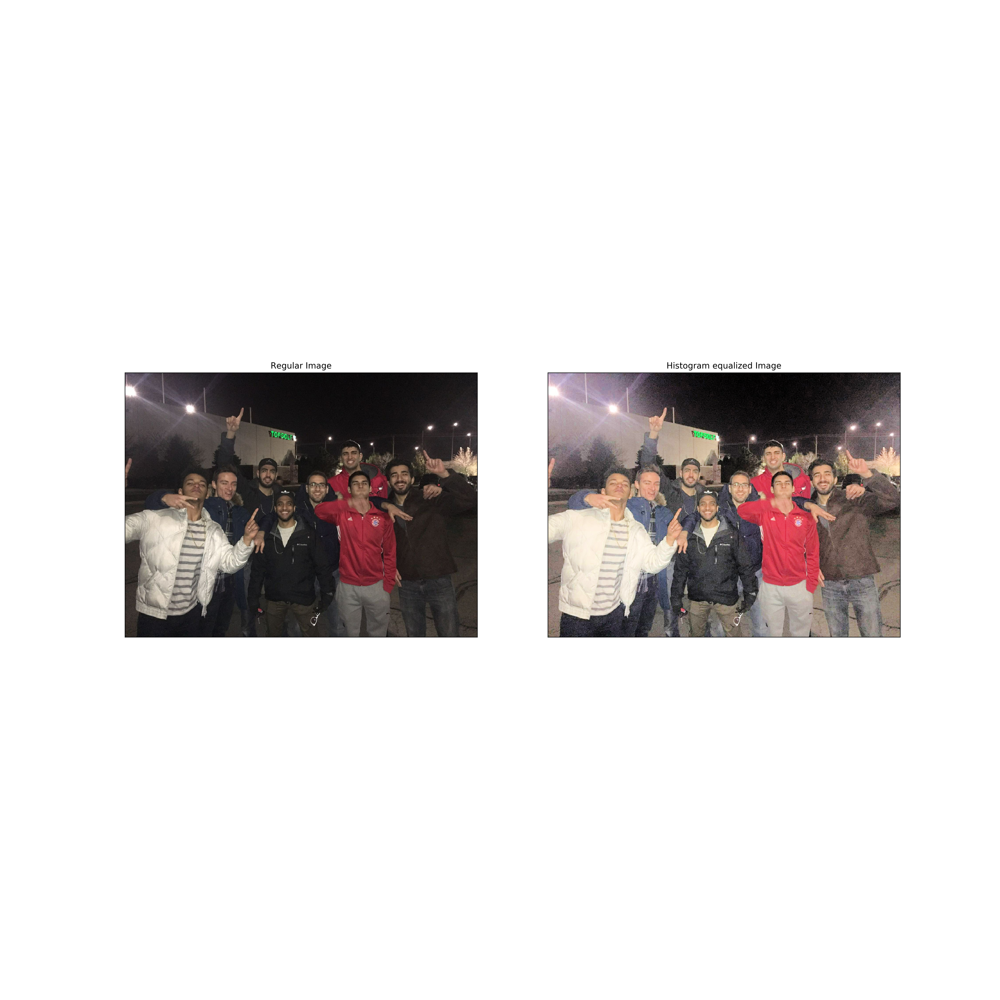

In [37]:
#Histogram equlization
image6 = cv2.imread(im6_file)
im6_contrast = cv2.cvtColor(image6, cv2.COLOR_BGR2HSV)

im6_contrast[:,:,2] = cv2.equalizeHist(im6_contrast[:,:,2])

im6_contrast = cv2.cvtColor(im6_contrast, cv2.COLOR_HSV2RGB)


fig, axes = plt.subplots(1, 2)
fig.set_size_inches(20, 20)
axes[0].imshow(im6, cmap = 'gray')
axes[0].set_title('Regular Image'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im6_contrast, cmap = 'gray')
axes[1].set_title('Histogram equalized Image'), axes[1].set_xticks([]), axes[1].set_yticks([])
plt.savefig('low_contrast_compare.jpg')


<IPython.core.display.Javascript object>


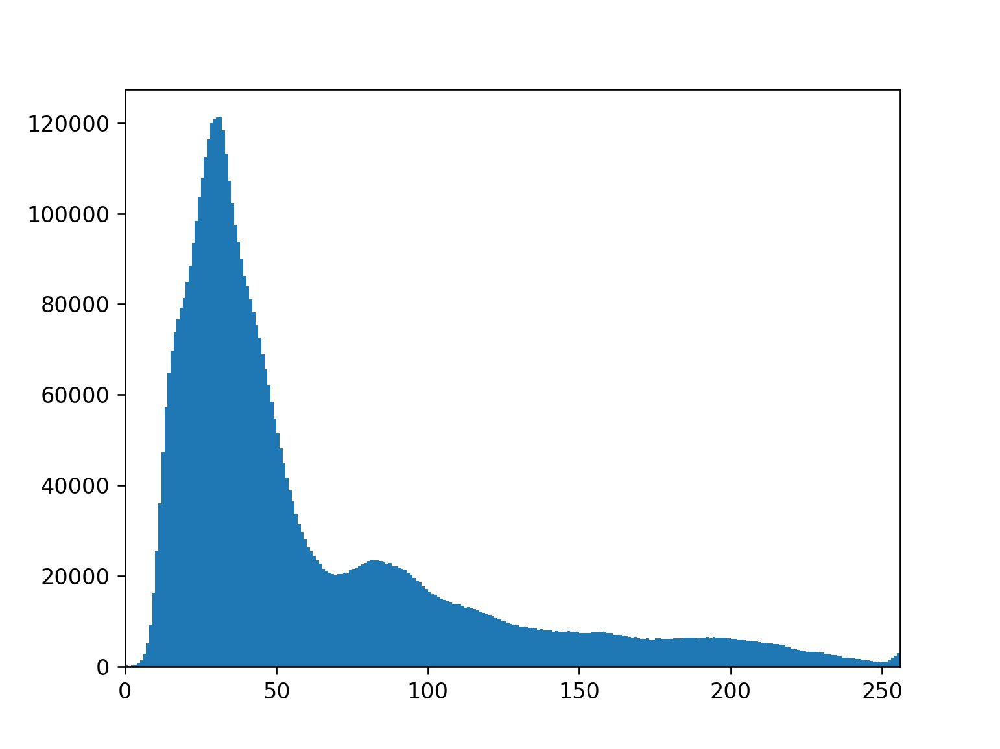

In [40]:
#histogram of regualar image

fig = plt.figure()
ax = plt.axes()
hist, bins = np.histogram(im6.flatten(),256,[0,256])
ax.hist(im6.flatten(),256,[0,256])
plt.xlim([0,256])
plt.show()

<IPython.core.display.Javascript object>


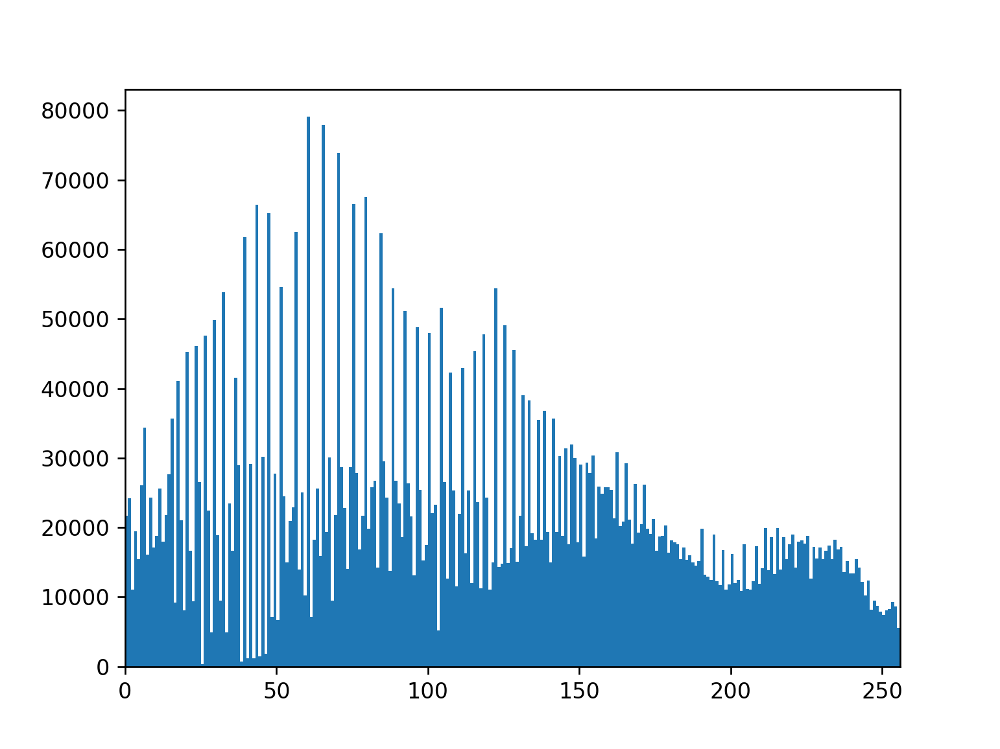

In [39]:
#histogram of proccessed image
fig = plt.figure()
ax = plt.axes()
hist, bins = np.histogram(im6_contrast.flatten(),256,[0,256])
ax.hist(im6_contrast.flatten(),256,[0,256])
plt.xlim([0,256])
plt.show()

## Color enhancement 

<IPython.core.display.Javascript object>


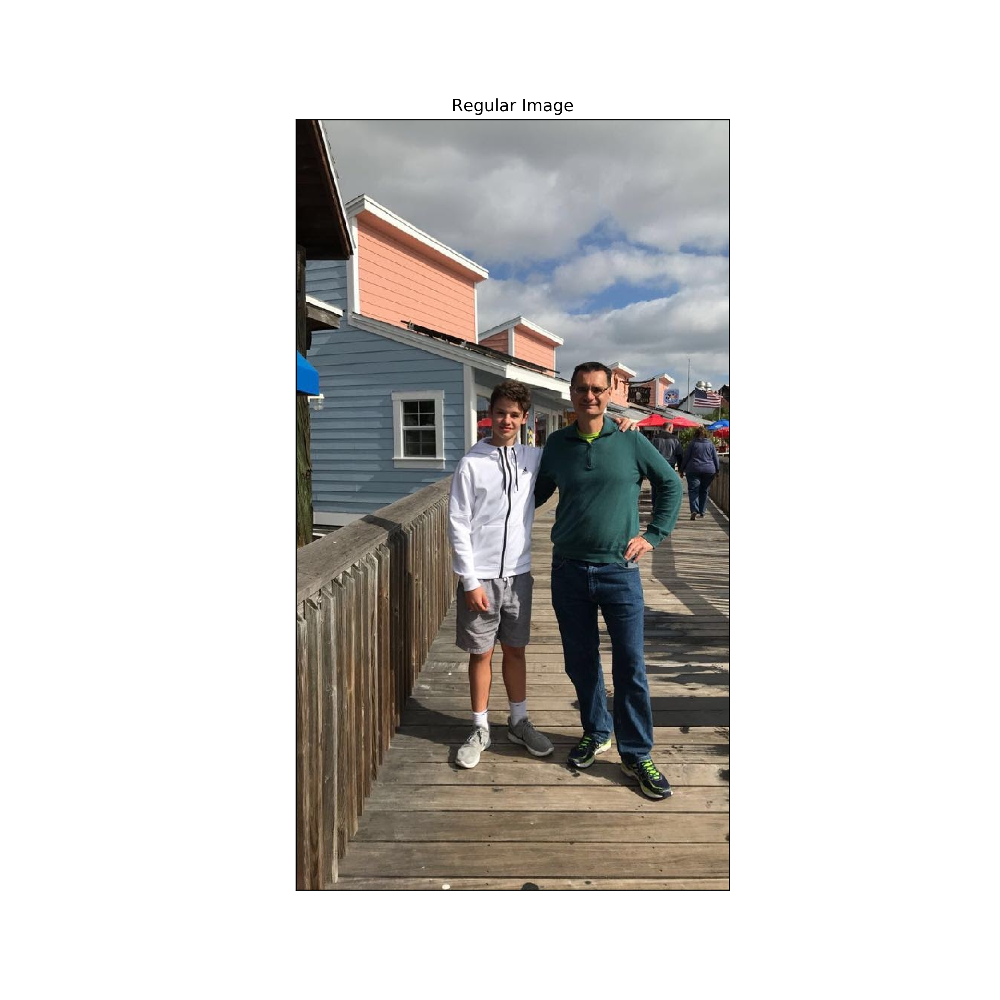

(Text(0.5, 1.0, 'Regular Image'), [], [])

In [41]:

color_enhancement_img = './ce.jpg'
ce_1 = cv2.imread(color_enhancement_img)
ce_1 = cv2.cvtColor(ce_1, cv2.COLOR_BGR2RGB)/255
fig, axes = plt.subplots(1, 1)
fig.set_size_inches(10, 10)
axes.imshow(ce_1)
axes.set_title('Regular Image'), axes.set_xticks([]), axes.set_yticks([])

<IPython.core.display.Javascript object>


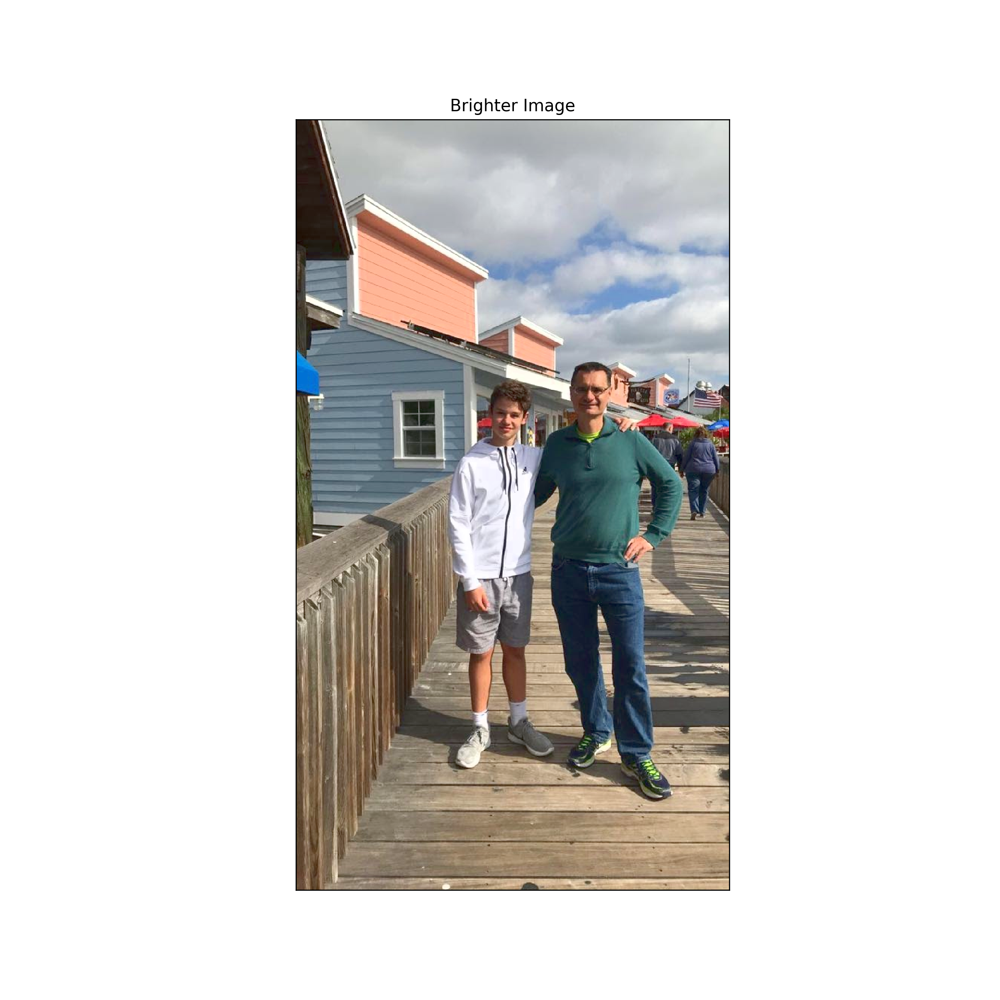

(Text(0.5, 1.0, 'Brighter Image'), [], [])

In [42]:
color_enhancement_img = './ce.jpg'
ce_2 = cv2.imread(color_enhancement_img)
hsv = cv2.cvtColor(ce_2,cv2.COLOR_BGR2HSV)

value = 24 

h,s,v = cv2.split(hsv)

v[v > 255 - value] = 255
v[v <= 255 - value] += value


hsv = cv2.merge((h,s,v))
ce_2 = cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)
fig, axes = plt.subplots(1, 1)
fig.set_size_inches(10, 10)
axes.imshow(ce_2)
axes.set_title('Brighter Image'), axes.set_xticks([]), axes.set_yticks([])

<IPython.core.display.Javascript object>


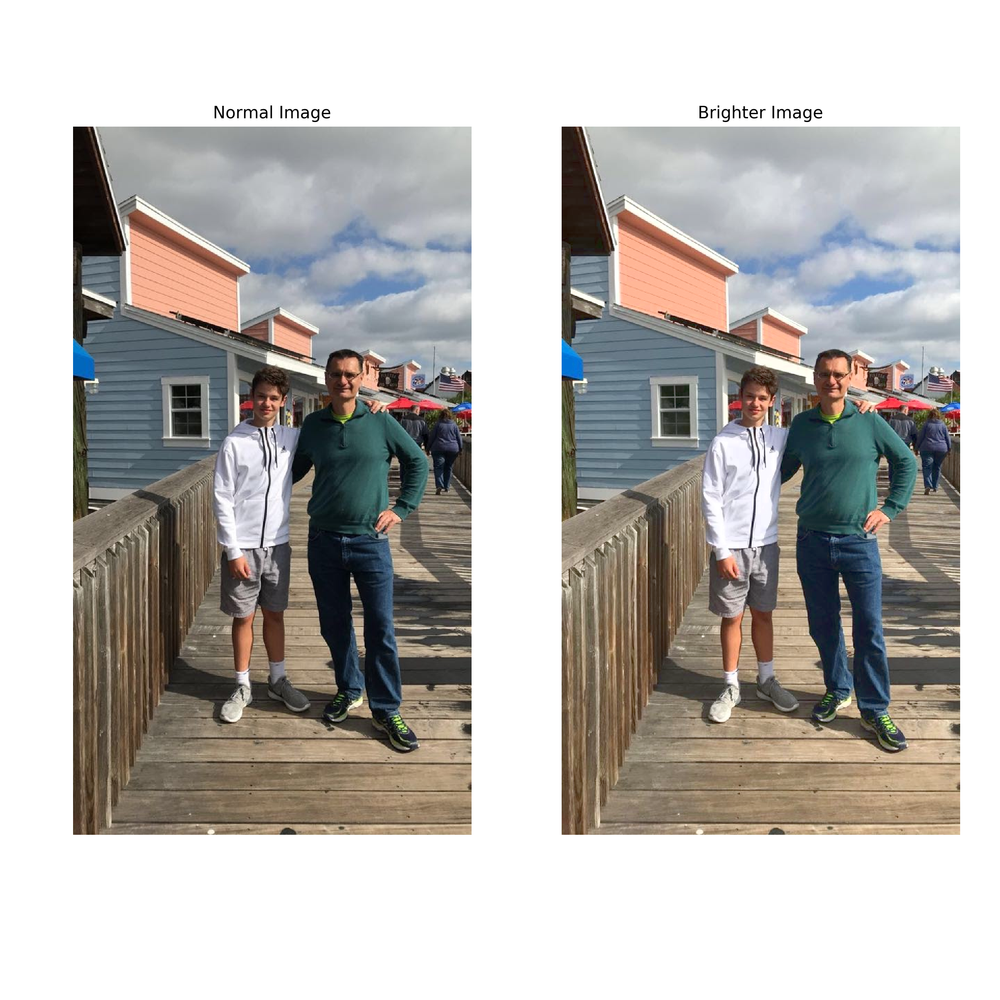

In [43]:
fig, axes = plt.subplots(1,2)
fig.tight_layout()
fig.set_size_inches(10, 10)
axes[0].imshow(ce_1)
axes[1].imshow(ce_2)
axes[0].axis('off')
axes[1].axis('off')
axes[0].title.set_text('Normal Image')
axes[1].title.set_text('Brighter Image')
plt.savefig('color_enhancement.png')

## Color shift

### Normal Image

<IPython.core.display.Javascript object>


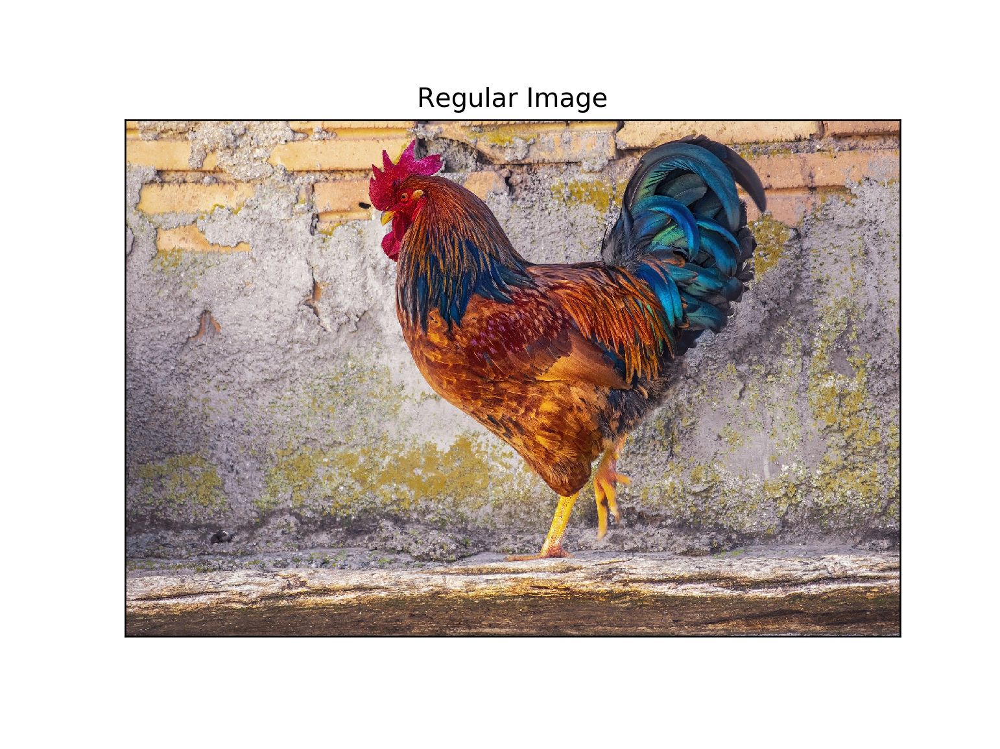

(Text(0.5, 1.0, 'Regular Image'), [], [])

In [44]:
#https://pixabay.com/photos/gallo-feathers-colorful-animals-4752996/
cs_file = './color_shift.jpg'
cs_1 = cv2.imread(cs_file)
cs_1 = cv2.cvtColor(cs_1, cv2.COLOR_BGR2RGB)/255
fig, axes = plt.subplots(1, 1)
axes.imshow(cs_1)
axes.set_title('Regular Image'), axes.set_xticks([]), axes.set_yticks([])

### More Red Image

<IPython.core.display.Javascript object>


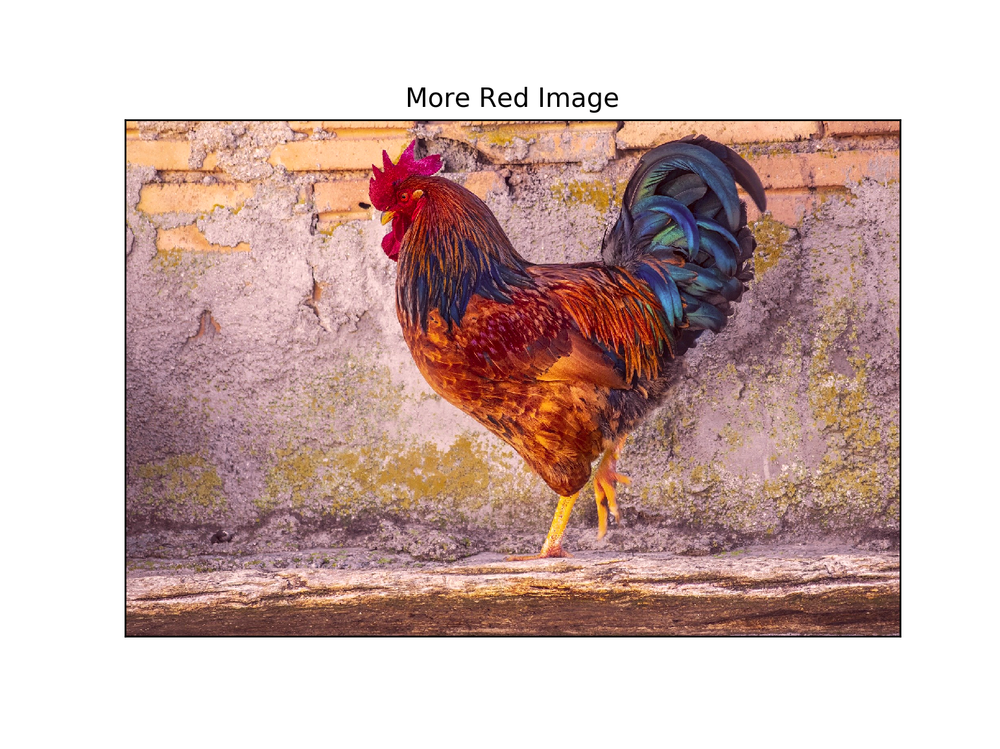

(Text(0.5, 1.0, 'More Red Image'), [], [])

In [45]:
#MORE RED
cs_file = './color_shift.jpg'
cs_2 = cv2.imread(cs_file)
cs_2_lab = cv2.cvtColor(cs_2, cv2.COLOR_BGR2Lab)

cs_2_lab[:,:,1] += 10
cs_2_lab[:,:,2] += 3
cs_2_lab = cv2.cvtColor(cs_2_lab, cv2.COLOR_Lab2RGB)
fig, axes = plt.subplots(1, 1)
axes.imshow(cs_2_lab)
axes.set_title('More Red Image'), axes.set_xticks([]), axes.set_yticks([])

### Less Yellow Image

<IPython.core.display.Javascript object>


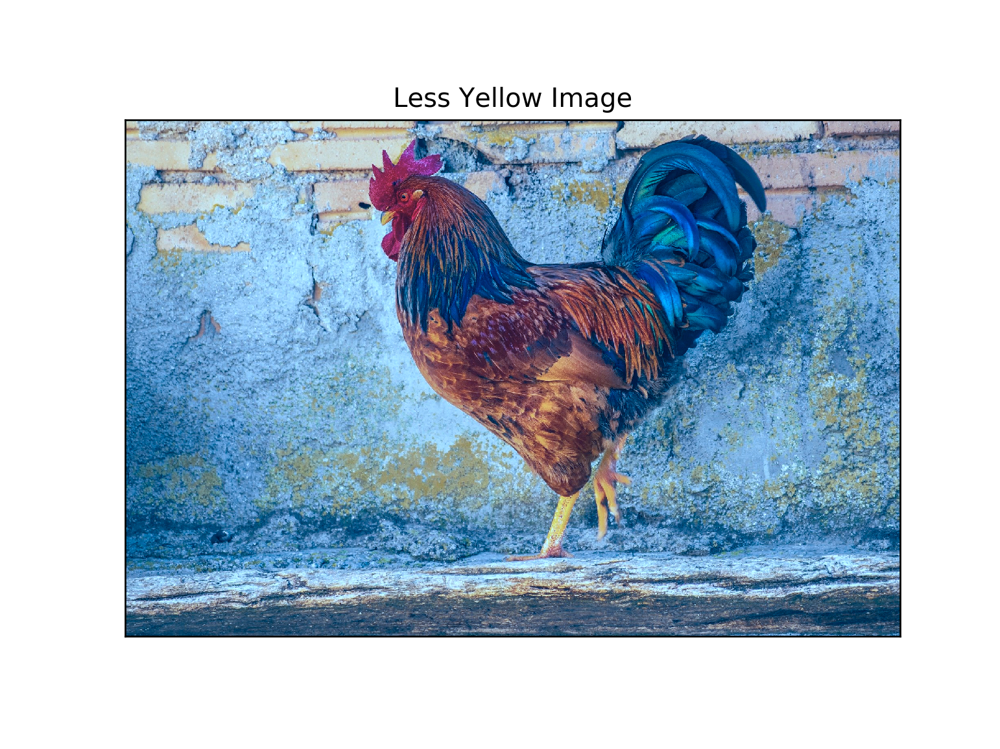

(Text(0.5, 1.0, 'Less Yellow Image'), [], [])

In [46]:
cs_file = './color_shift.jpg'
cs_3 = cv2.imread(cs_file)
cs_3_lab = cv2.cvtColor(cs_3, cv2.COLOR_BGR2Lab)


cs_3_lab[:,:,2] -= 30
cs_3_lab[:,:,1] -= 10
cs_3_lab = cv2.cvtColor(cs_3_lab, cv2.COLOR_Lab2RGB)
fig, axes = plt.subplots(1, 1)
axes.imshow(cs_3_lab)
axes.set_title('Less Yellow Image'), axes.set_xticks([]), axes.set_yticks([])

<IPython.core.display.Javascript object>


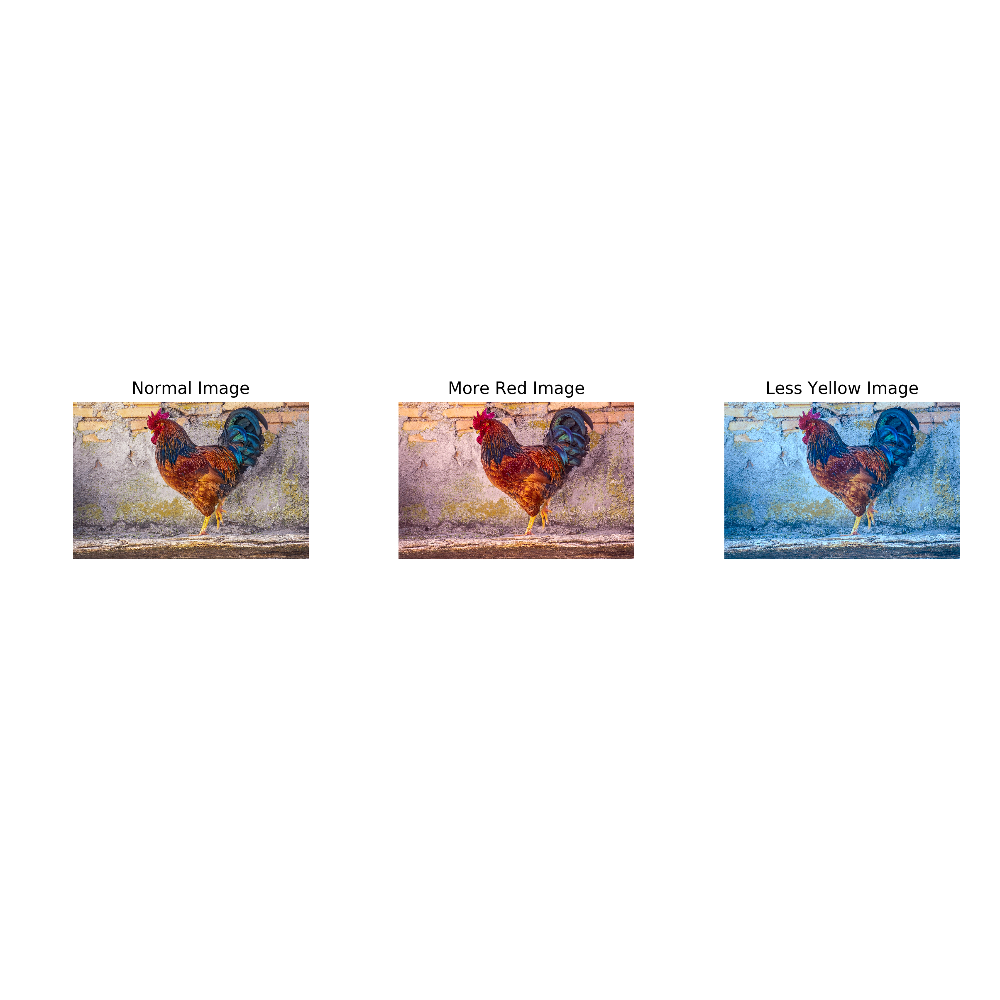

In [47]:
fig, axes = plt.subplots(1,3)
fig.tight_layout()
fig.set_size_inches(10, 10)
axes[0].imshow(cs_1)
axes[1].imshow(cs_2_lab)
axes[2].imshow(cs_3_lab)
axes[0].axis('off')
axes[1].axis('off')
axes[2].axis('off')
axes[0].title.set_text('Normal Image')
axes[1].title.set_text('More Red Image')
axes[2].title.set_text('Less Yellow Image')
plt.savefig('color_shift.png')

# Bells & Whistles 

## Laplacian and Gausian Pyramid

In [48]:
def gaus_lp_pyramid(hybrid_image, cutoff_low):
    gaus = []
    lp = []
    gaus.append(hybrid_image)
    lp.append(hybrid_image)
    for i in range(5):
        fil_low = utils.gaussian_kernel(cutoff_low, 3 * cutoff_low)    
        low_image = cv2.filter2D(hybrid_image,-1,fil_low)
        lp_image = hybrid_image - low_image
        gaus.append(low_image)
        lp.append(lp_image)
        hybrid_image = hybrid_image[0::2,0::2]
    return gaus,lp

<IPython.core.display.Javascript object>


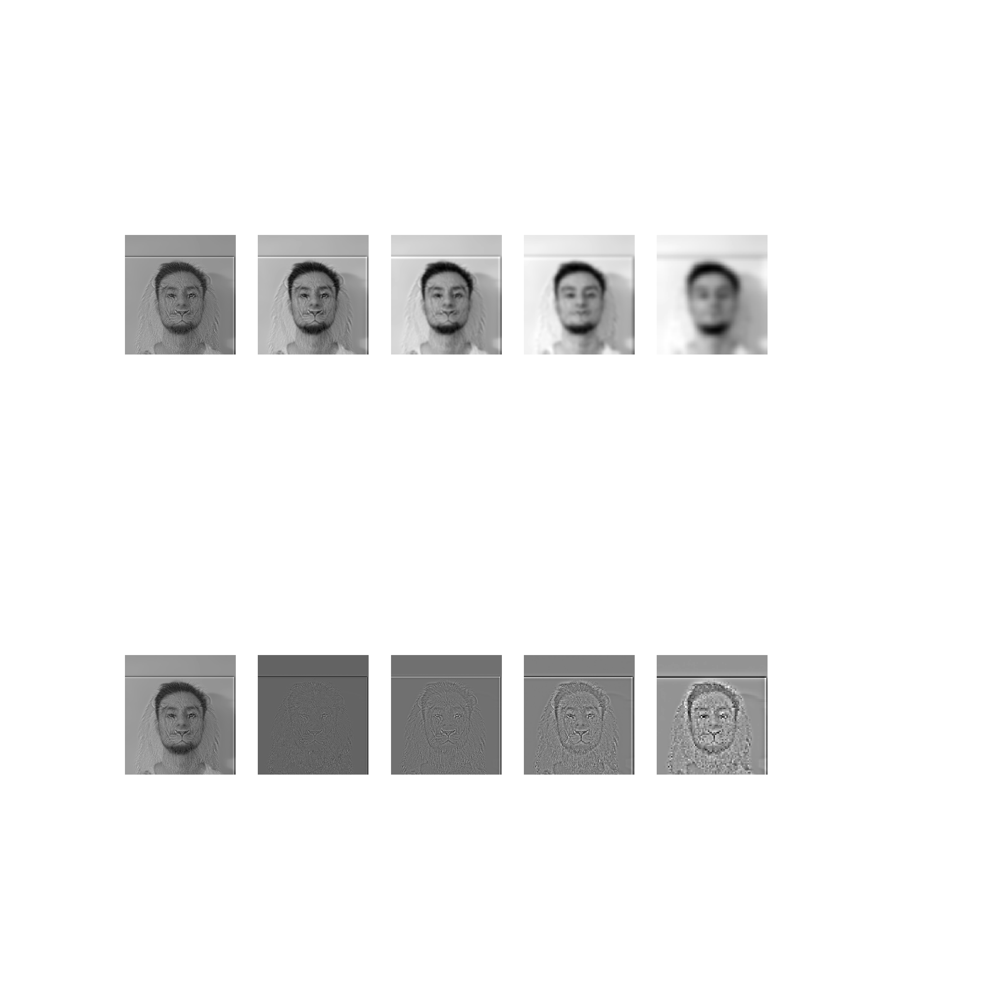

In [49]:
gaus_pyramid, lp_pyramid = gaus_lp_pyramid(hybrid_3, 2)


    
fig, axes = plt.subplots(2,6) 
fig.set_size_inches(10, 10)
axes[0][0].imshow(gaus_pyramid[0], cmap='gray')
axes[0][1].imshow(gaus_pyramid[1], cmap='gray')
axes[0][2].imshow(gaus_pyramid[2], cmap='gray')
axes[0][3].imshow(gaus_pyramid[3], cmap='gray')
axes[0][4].imshow(gaus_pyramid[4], cmap='gray')
axes[0][0].axis('off') 
axes[0][1].axis('off') 
axes[0][2].axis('off')
axes[0][3].axis('off')
axes[0][4].axis('off')
axes[0][5].axis('off')
axes[1][0].imshow(lp_pyramid[0], cmap='gray')
axes[1][1].imshow(lp_pyramid[1], cmap='gray')
axes[1][2].imshow(lp_pyramid[2], cmap='gray')
axes[1][3].imshow(lp_pyramid[3], cmap='gray')
axes[1][4].imshow(lp_pyramid[4], cmap='gray')
axes[1][0].axis('off') 
axes[1][1].axis('off') 
axes[1][2].axis('off')
axes[1][3].axis('off')
axes[1][4].axis('off')
axes[1][5].axis('off')
plt.show()
plt.savefig('tarik_lion_Laplacian_pyramid.png')

## Color to enhance the effect of hybrid images.

In [50]:
im1_file_color = './tarik.jpg'
im2_file_color = './lion.jpg'

im1_color = cv2.imread(im1_file_color)
im2_color = cv2.imread(im2_file_color)

im1_color, im2_color = utils.align_images(im1_file_color, im2_file_color,pts_im1,pts_im5,save_images=False)
im1_color = cv2.cvtColor(im1_color, cv2.COLOR_BGR2RGB)/255
im2_color = cv2.cvtColor(im2_color, cv2.COLOR_BGR2RGB)/255


<IPython.core.display.Javascript object>


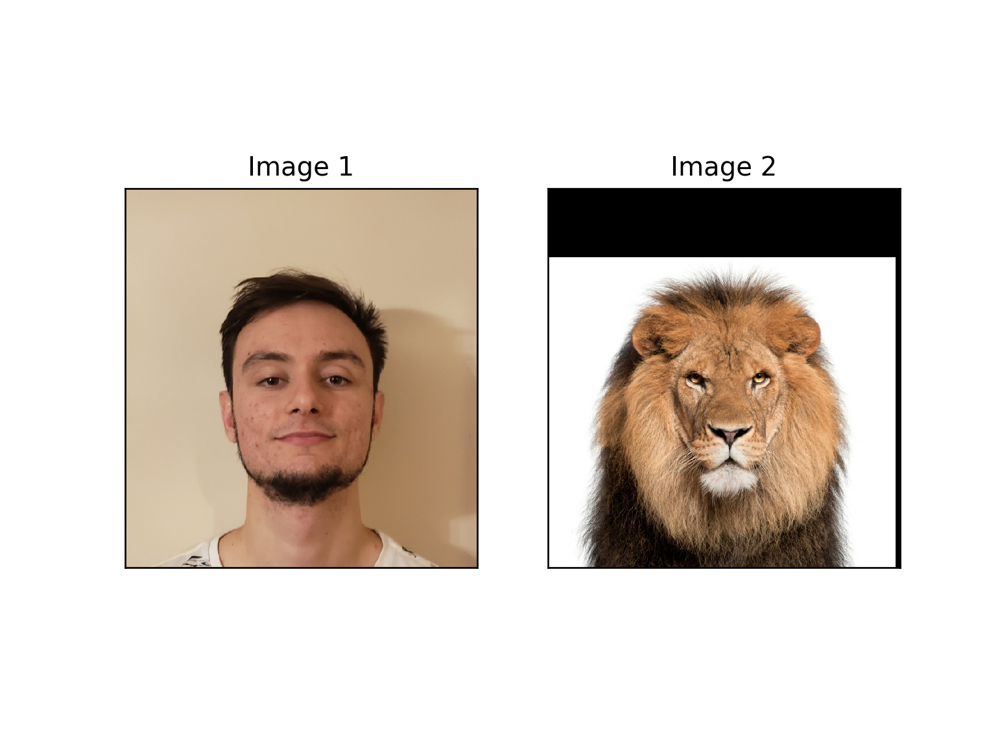

In [51]:
fig, axes = plt.subplots(1, 2)
axes[0].imshow(im1_color)
axes[0].set_title('Image 1'), axes[0].set_xticks([]), axes[0].set_yticks([])
axes[1].imshow(im2_color)
axes[1].set_title('Image 2'), axes[1].set_xticks([]), axes[1].set_yticks([]);

In [52]:
cutoff_low = 3
cutoff_high = 5

hybrid_color,lp_color,gaus_color = hybridImage(im1_color, im2_color, cutoff_low, cutoff_high)



<IPython.core.display.Javascript object>


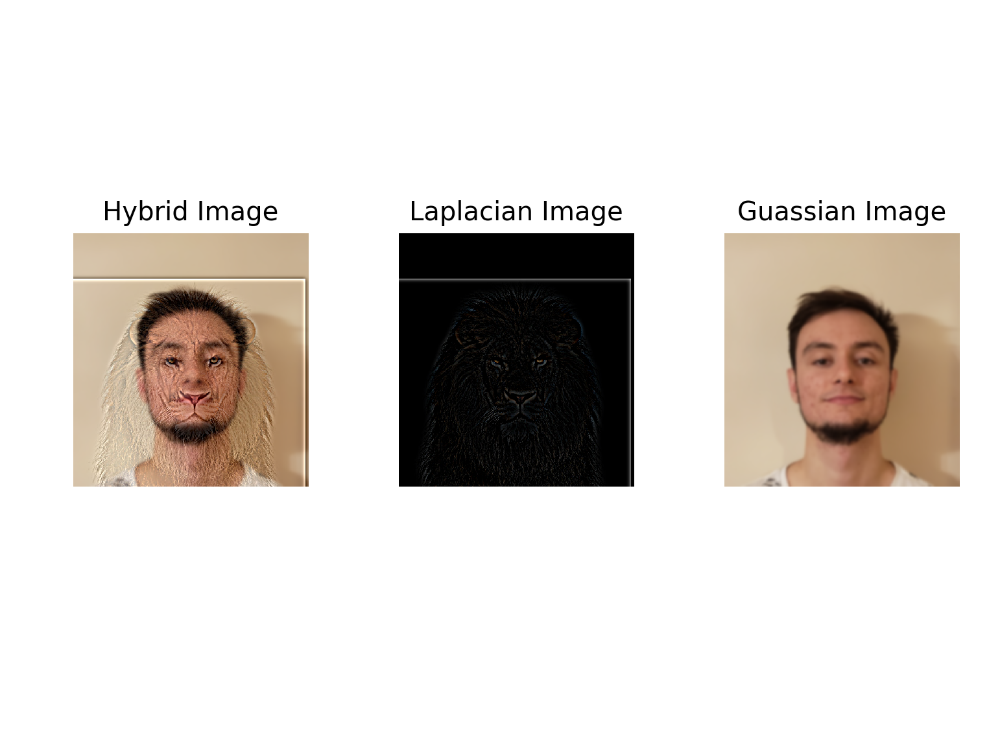

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [63]:
fig, axes = plt.subplots(1,3)
fig.tight_layout()
axes[0].imshow(hybrid_color)
axes[1].imshow(lp_color)
axes[2].imshow(gaus_color)
axes[0].axis('off')
axes[1].axis('off')
axes[2].axis('off')
axes[0].title.set_text('Hybrid Image')
axes[1].title.set_text('Laplacian Image')
axes[2].title.set_text('Guassian Image')
plt.savefig('tarik_lion_compare_color.png')

<IPython.core.display.Javascript object>


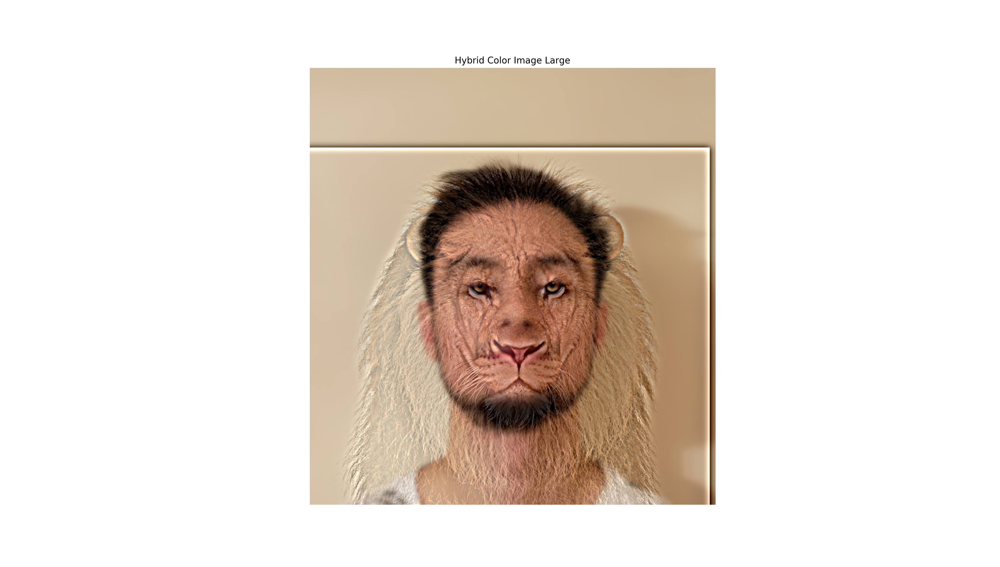

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [55]:
fig, axes = plt.subplots(1,1)
axes.imshow(hybrid_color)
axes.axis('off')
axes.title.set_text('Hybrid Color Image Large')
fig.set_size_inches(18.5, 10.5)
plt.savefig('tarik_lion_color.png')